In [1]:
# Requirements
!pip install torch torchvision tqdm matplotlib opencv-python

In [2]:
# Imports
import os
import cv2
import csv
import torch
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import time
from datetime import timedelta

# Configuration Dictionary
CONFIG = {
    "dataset_folder": "./dataset",      # Folder with input images
    "output_folder": "./outputs",       # Folder to save outputs
    "device": "cuda" if torch.cuda.is_available() else "cpu",  # GPU if available
    "batch_size": 3,                    # Process 3 images per batch
    "resize_to": (384, 384),            # Model input size
    "model_type": "DPT_Large",          # MiDaS model variant
    "save_npz": True,                   # Save final results as .npz archive
    "colormap": "inferno",              # Colormap for depth visualization
    "display_images": True,             # Show images in notebook/GUI
    "save_visualizations": True,        # Save combined batch visualization images
}

In [3]:
# Setup output folders (depth, log, vis, csv, npy)
def setup_output_folders(base_folder):
    subfolders = ["depth", "log", "vis", "csv", "npy"]
    paths = {}
    for sub in subfolders:
        path = os.path.join(base_folder, sub)
        os.makedirs(path, exist_ok=True)
        paths[sub] = path
    return paths

In [4]:
# Load MiDaS model and corresponding transforms
def load_midas_model(device, model_type="DPT_Large"):
    print(f"Loading MiDaS model '{model_type}' on device {device}...")
    midas = torch.hub.load("intel-isl/MiDaS", model_type, trust_repo=True)
    midas.to(device).eval()

    midas_transforms = torch.hub.load("intel-isl/MiDaS", "transforms", trust_repo=True)
    transform = midas_transforms.dpt_transform if "DPT" in model_type else midas_transforms.small_transform
    print("Model loaded successfully.")
    return midas, transform

In [5]:
# Get all image file paths from dataset folder
def get_image_paths(folder, valid_extensions=(".jpg", ".jpeg", ".png")):
    return [os.path.join(folder, f) for f in os.listdir(folder) if f.lower().endswith(valid_extensions)]

# Read image, convert BGR to RGB and resize if needed
def read_image(path, resize_to=None):
    img_bgr = cv2.imread(path)
    if img_bgr is None:
        print(f"[WARNING] Couldn't read image: {path}")
        return None
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    if resize_to:
        img_rgb = cv2.resize(img_rgb, resize_to)
    return img_rgb

In [6]:
# Predict depth map from RGB image using MiDaS model
def predict_depth(img_rgb, midas, transform, device):

    # Apply MiDaS transform and send tensor to device
    input_tensor = transform(img_rgb).to(device)

    with torch.no_grad():
        prediction = midas(input_tensor)

        # Upsample to original image size using bicubic interpolation
        prediction = torch.nn.functional.interpolate(
            prediction.unsqueeze(1),
            size=img_rgb.shape[:2],
            mode="bicubic",
            align_corners=False,
        ).squeeze()

    depth_map = prediction.cpu().numpy()

    # Normalize depth map to 0-255 for visualization
    d_min, d_max = depth_map.min(), depth_map.max()
    norm = (depth_map - d_min) / (d_max - d_min + 1e-8)
    return (norm * 255).astype(np.uint8)

In [7]:
# Apply Gaussian blur and histogram equalization to smooth and enhance depth maps
def postprocess_depth(depth, blur_kernel=(5, 5), clip_percentile=2):
    depth_blurred = cv2.GaussianBlur(depth, blur_kernel, 0)
    depth_eq = cv2.equalizeHist(depth_blurred)

    min_val = np.percentile(depth_eq, clip_percentile)
    max_val = np.percentile(depth_eq, 100 - clip_percentile)
    depth_clipped = np.clip(depth_eq, min_val, max_val)

    depth_rescaled = ((depth_clipped - min_val) / (max_val - min_val + 1e-8) * 255).astype(np.uint8)
    return depth_rescaled

In [8]:
# Normalize depth map with log scale for better visualization of depth differences
def normalize_log(depth_map):
    # Avoid log(0) by adding small epsilon
    depth_map = depth_map.astype(np.float32) + 1e-6
    log_depth = np.log(depth_map)
    log_min, log_max = log_depth.min(), log_depth.max()
    norm_log = (log_depth - log_min) / (log_max - log_min + 1e-8)
    return (norm_log * 255).astype(np.uint8)

In [9]:
# Visualization Function with Customizable Layout
def plot_images_and_depths_one_by_one(imgs_rgb, depth_maps, titles=None, cmap="inferno"):
    for i in range(len(imgs_rgb)):
        plt.figure(figsize=(10, 4))
        plt.subplot(1, 2, 1)
        plt.imshow(imgs_rgb[i])
        plt.title(titles[i] if titles else "Original")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.imshow(depth_maps[i], cmap=cmap)
        plt.title("Depth Map")
        plt.axis("off")
        plt.tight_layout()
        plt.show()

def plot_images_and_depths_with_log(rgb_list, depth_list, log_depth_list, titles, cmap='plasma'):
    for rgb, depth, log_depth, title in zip(rgb_list, depth_list, log_depth_list, titles):
        plt.figure(figsize=(18, 6))

        plt.subplot(1, 3, 1)
        plt.imshow(rgb)
        plt.title(f"{title} - Image")
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(depth, cmap=cmap)
        plt.title("Depth Map")
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(log_depth, cmap=cmap)
        plt.title("Depth Map (Log Norm)")
        plt.axis('off')

        plt.tight_layout()
        plt.show()

In [10]:
# Save a 3-in-1 visualization
def save_visualization_triplet(rgb, depth, log_depth, title, out_path, cmap='plasma', dpi=150, show_title=True):
    os.makedirs(os.path.dirname(out_path), exist_ok=True)

    fig, axs = plt.subplots(1, 3, figsize=(18, 6), facecolor='white')

    axs[0].imshow(rgb)
    axs[0].set_title("Original Image")
    axs[0].axis("off")

    axs[1].imshow(depth, cmap=cmap)
    axs[1].set_title("Depth Map")
    axs[1].axis("off")

    axs[2].imshow(log_depth, cmap=cmap)
    axs[2].set_title("Log-Normalized Depth")
    axs[2].axis("off")

    if show_title:
        fig.suptitle(title, fontsize=16)

    plt.tight_layout()
    fig.savefig(out_path, bbox_inches='tight', dpi=dpi)
    plt.close()

In [11]:
# Plot 4-panel visualization for a single image and its depth maps
def plot_depth_comparison_4view(img_rgb, depth_raw, log_depth, log_depth_post, title="", cmap="inferno"):
    plt.figure(figsize=(20, 5))
    plt.subplot(1, 4, 1)
    plt.imshow(img_rgb)
    plt.title("Original")
    plt.axis("off")

    plt.subplot(1, 4, 2)
    plt.imshow(depth_raw, cmap=cmap)
    plt.title("Depth Map")
    plt.axis("off")

    plt.subplot(1, 4, 3)
    plt.imshow(log_depth, cmap=cmap)
    plt.title("Log-Normalized")
    plt.axis("off")

    plt.subplot(1, 4, 4)
    plt.imshow(log_depth_post, cmap=cmap)
    plt.title("Post-Processed")
    plt.axis("off")

    plt.suptitle(title, fontsize=14)
    plt.tight_layout()
    plt.show()

In [12]:
# Save combined visualization of 3 images and their depth maps in one figure
def save_batch_visualization(rgb_list, depth_list, log_depth_list, log_depth_post_list, titles, out_path, cmap='inferno'):
    os.makedirs(os.path.dirname(out_path), exist_ok=True)
    n = len(rgb_list)
    fig, axs = plt.subplots(n, 4, figsize=(20, 5 * n))
    for i in range(n):
        axs[i, 0].imshow(rgb_list[i])
        axs[i, 0].set_title(f"{titles[i]} - Original")
        axs[i, 0].axis("off")

        axs[i, 1].imshow(depth_list[i], cmap=cmap)
        axs[i, 1].set_title("Depth Map")
        axs[i, 1].axis("off")

        axs[i, 2].imshow(log_depth_list[i], cmap=cmap)
        axs[i, 2].set_title("Log-Normalized")
        axs[i, 2].axis("off")

        axs[i, 3].imshow(log_depth_post_list[i], cmap=cmap)
        axs[i, 3].set_title("Post-Processed")
        axs[i, 3].axis("off")

    plt.tight_layout()
    fig.suptitle("Batch Depth Estimation Results", fontsize=18)
    plt.subplots_adjust(top=0.95)
    fig.savefig(out_path, bbox_inches='tight', dpi=150)
    plt.close(fig)

In [13]:
# Export statistics to .csv format
def append_depth_stats(csv_path, filename, depth_map):
    stats = {
        "filename": filename,
        "min": float(np.min(depth_map)),
        "max": float(np.max(depth_map)),
        "mean": float(np.mean(depth_map)),
        "std": float(np.std(depth_map)),
    }

    file_exists = os.path.exists(csv_path)
    with open(csv_path, "a", newline="") as csvfile:
        writer = csv.DictWriter(csvfile, fieldnames=stats.keys())
        if not file_exists:
            writer.writeheader()
        writer.writerow(stats)

In [14]:
# Save Depth Maps (.npz File)
def save_depth_map(depth_map, path):
    cv2.imwrite(path, depth_map)

# Save results to compressed NPZ archive
def save_npz_file(output_path, imgs_rgb, depth_maps, titles):
    np.savez_compressed(
        output_path,
        images=np.stack(imgs_rgb),
        depths=np.stack(depth_maps),
        titles=np.array(titles)
    )

In [15]:
# Main function to run depth estimation on dataset folder in batches of 3 images
def run_depth_estimation(config):
    start_time_total = time.time()
    device = torch.device(config["device"])
    os.makedirs(config["output_folder"], exist_ok=True)

    midas, transform = load_midas_model(device, config["model_type"])
    image_paths = get_image_paths(config["dataset_folder"])
    print(f"Found {len(image_paths)} images.")

    batch_rgb, batch_depth, batch_log, batch_log_post, batch_titles = [], [], [], [], []

    for idx, path in enumerate(tqdm(image_paths, desc="Processing Images")):
        img_rgb = read_image(path, config["resize_to"])
        if img_rgb is None:
            continue

        start_infer = time.time()
        depth_map = predict_depth(img_rgb, midas, transform, device)
        # Resize depth map back to original size (before resizing input)
        depth_map_resized = cv2.resize(depth_map, (img_rgb.shape[1], img_rgb.shape[0]), interpolation=cv2.INTER_CUBIC)
        log_depth_map = normalize_log(depth_map_resized)
        log_depth_map_post = postprocess_depth(log_depth_map)
        elapsed = time.time() - start_infer

        base_name = os.path.splitext(os.path.basename(path))[0]

        # Save individual depth maps
        save_depth_map(depth_map_resized, os.path.join(config["output_folder"], f"{base_name}_depth.png"))
        save_depth_map(log_depth_map, os.path.join(config["output_folder"], f"{base_name}_depth_log.png"))
        save_depth_map(log_depth_map_post, os.path.join(config["output_folder"], f"{base_name}_depth_log_post.png"))

        tqdm.write(f"{base_name}: Inference time {elapsed:.2f} sec")

        batch_rgb.append(img_rgb)
        batch_depth.append(depth_map_resized)
        batch_log.append(log_depth_map)
        batch_log_post.append(log_depth_map_post)
        batch_titles.append(base_name)

        # Process batch when it reaches batch_size or at the end
        if len(batch_rgb) == config["batch_size"] or (idx + 1) == len(image_paths):
            # Display images if enabled
            if config["display_images"]:
                for i in range(len(batch_rgb)):
                    plot_depth_comparison_4view(
                        batch_rgb[i],
                        batch_depth[i],
                        batch_log[i],
                        batch_log_post[i],
                        title=batch_titles[i],
                        cmap=config["colormap"]
                    )

            # Save combined visualization image for batch
            if config["save_visualizations"]:
                vis_path = os.path.join(config["output_folder"], f"batch_{idx // config['batch_size'] + 1}_visualization.png")
                save_batch_visualization(batch_rgb, batch_depth, batch_log, batch_log_post, batch_titles, vis_path, cmap=config["colormap"])

            # Clear batch lists
            batch_rgb.clear()
            batch_depth.clear()
            batch_log.clear()
            batch_log_post.clear()
            batch_titles.clear()

    # Save all results in one NPZ file for further use
    if config["save_npz"]:
        print("Saving final NPZ archive...")
        final_rgb, final_depths, final_titles = [], [], []
        for path in image_paths:
            name = os.path.splitext(os.path.basename(path))[0]
            rgb = read_image(path, config["resize_to"])
            depth_path = os.path.join(config["output_folder"], f"{name}_depth_log_post.png")
            if rgb is not None and os.path.exists(depth_path):
                depth = cv2.imread(depth_path, cv2.IMREAD_GRAYSCALE)
                depth = cv2.resize(depth, (rgb.shape[1], rgb.shape[0]))
                final_rgb.append(rgb)
                final_depths.append(depth)
                final_titles.append(name)

        npz_path = os.path.join(config["output_folder"], "depth_estimation_results_postprocessed.npz")
        save_npz_file(npz_path, final_rgb, final_depths, final_titles)
        print(f"Saved NPZ file to {npz_path}")

    print(f"\nFinished. Total time: {timedelta(seconds=int(time.time() - start_time_total))}")

Loading MiDaS model 'DPT_Large' on device cpu...


Using cache found in C:\Users\anton/.cache\torch\hub\intel-isl_MiDaS_master
C:\Users\anton\anaconda3\Lib\site-packages\timm\models\layers\__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)
Using cache found in C:\Users\anton/.cache\torch\hub\intel-isl_MiDaS_master


Model loaded successfully.
Found 51 images.


Processing Images:   2%|▏         | 1/51 [00:03<02:50,  3.41s/it]

animals: Inference time 3.35 sec


Processing Images:   4%|▍         | 2/51 [00:06<02:33,  3.12s/it]

animals2: Inference time 2.91 sec


Processing Images:   4%|▍         | 2/51 [00:09<02:33,  3.12s/it]

basketball: Inference time 3.02 sec


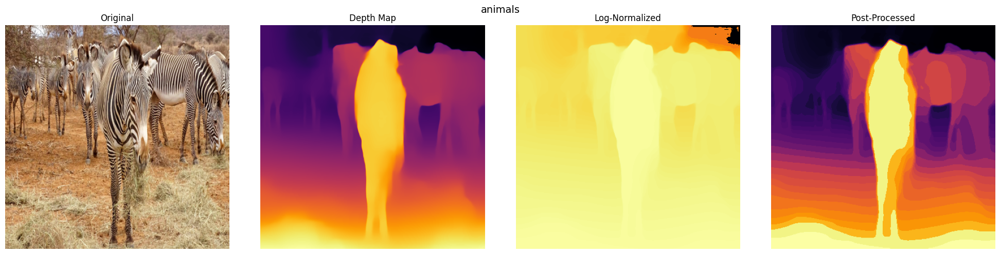

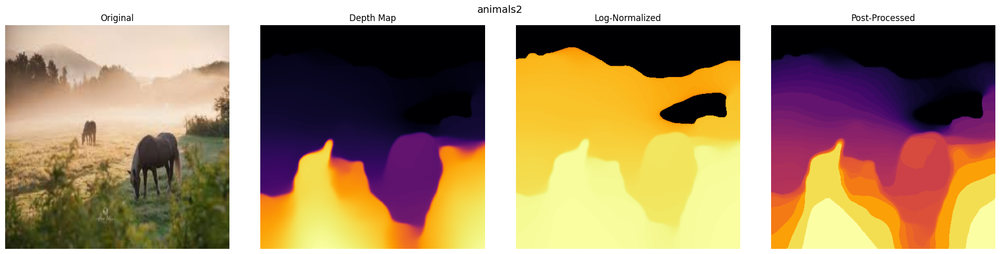

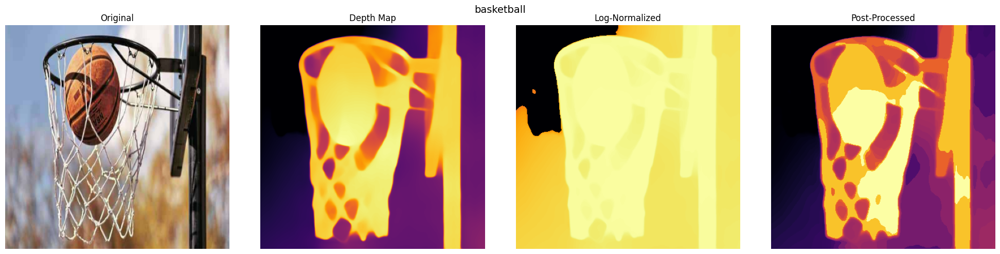

Processing Images:   8%|▊         | 4/51 [00:15<02:59,  3.82s/it]

bird: Inference time 2.94 sec


Processing Images:  10%|▉         | 5/51 [00:18<02:40,  3.49s/it]

boat: Inference time 2.87 sec


Processing Images:  10%|▉         | 5/51 [00:21<02:40,  3.49s/it]

bridge: Inference time 2.87 sec


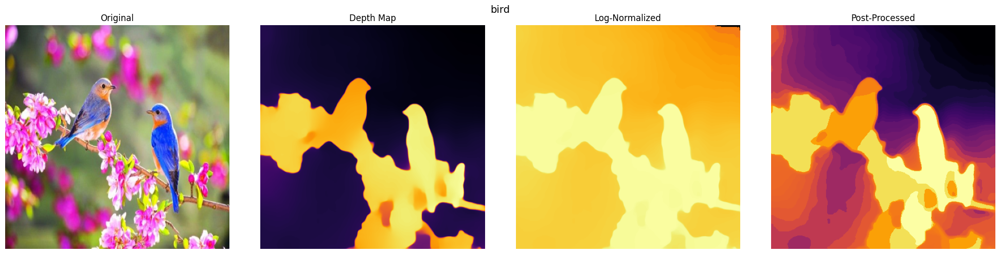

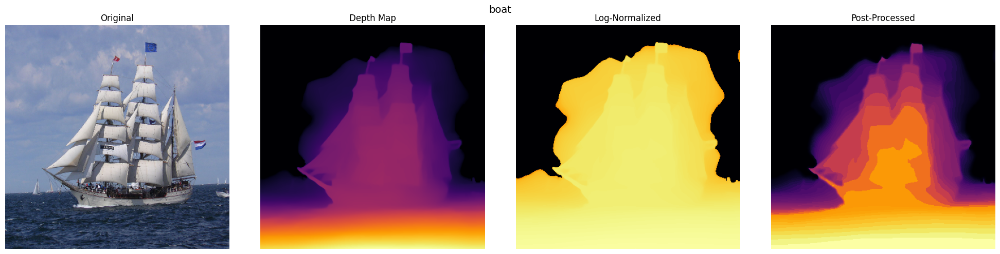

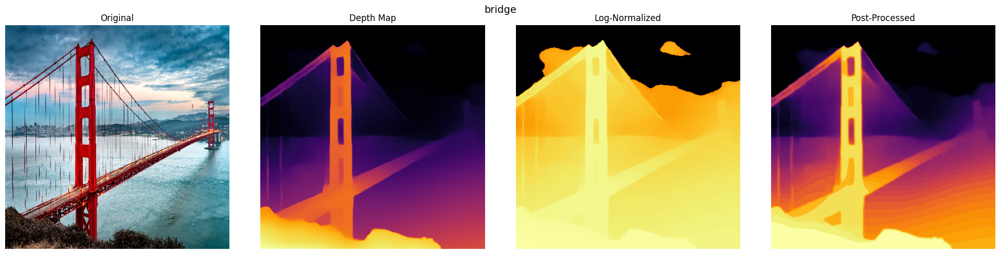

Processing Images:  14%|█▎        | 7/51 [00:27<02:53,  3.95s/it]

building: Inference time 3.10 sec


Processing Images:  16%|█▌        | 8/51 [00:30<02:36,  3.65s/it]

building_construction: Inference time 2.98 sec


Processing Images:  16%|█▌        | 8/51 [00:33<02:36,  3.65s/it]

building_paris: Inference time 2.94 sec


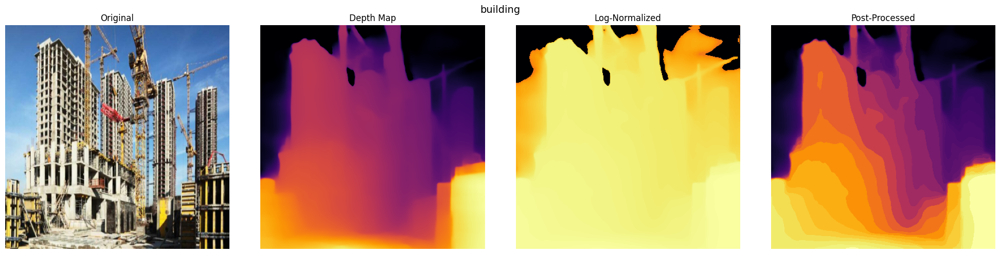

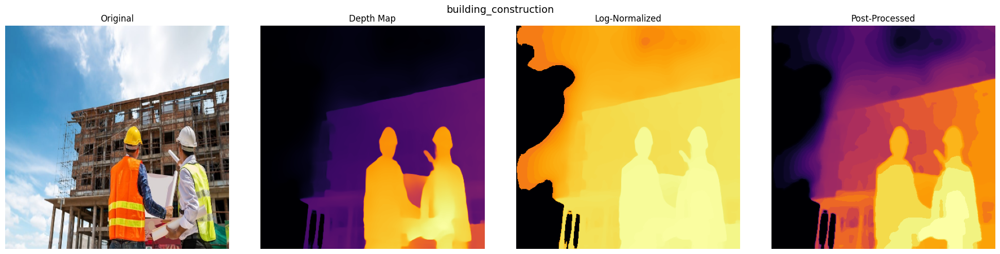

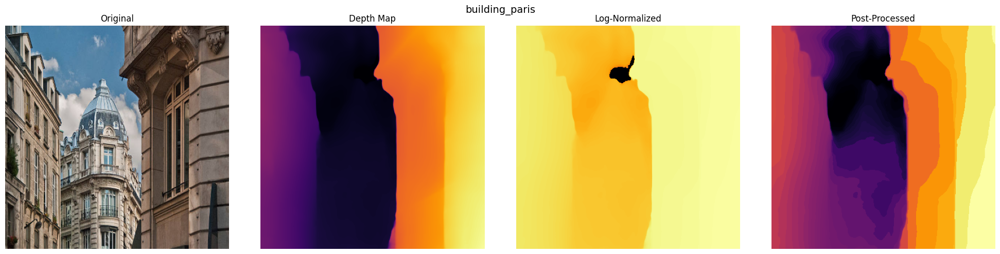

Processing Images:  20%|█▉        | 10/51 [00:38<02:38,  3.87s/it]

campaign: Inference time 2.96 sec


Processing Images:  22%|██▏       | 11/51 [00:42<02:27,  3.68s/it]

campaign2: Inference time 3.22 sec


Processing Images:  22%|██▏       | 11/51 [00:45<02:27,  3.68s/it]

campaign3: Inference time 3.23 sec


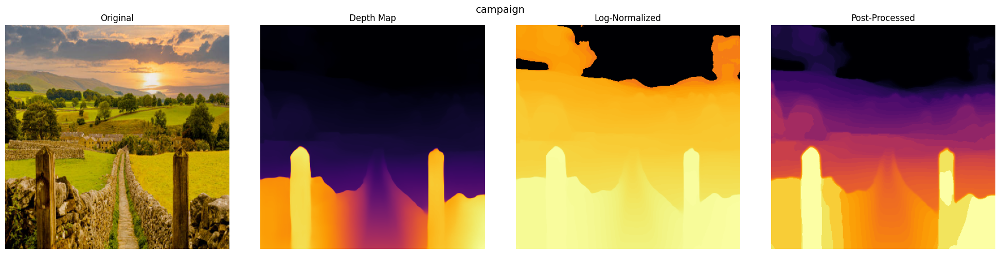

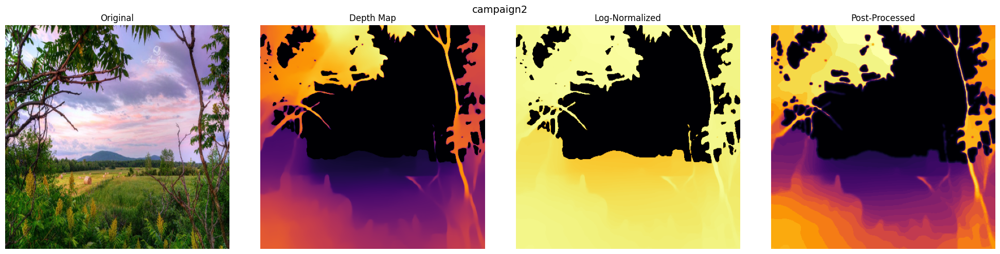

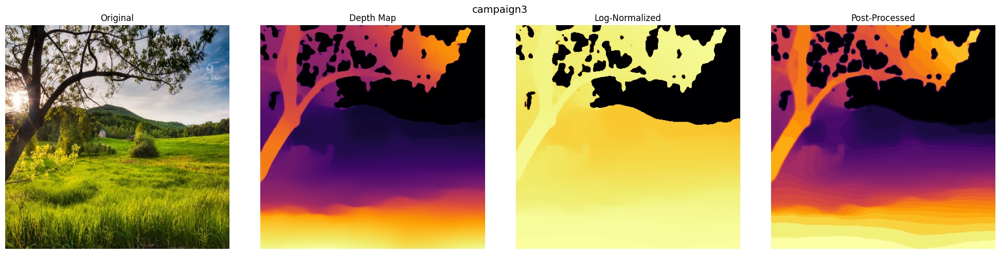

Processing Images:  25%|██▌       | 13/51 [00:50<02:29,  3.93s/it]

car_road: Inference time 2.91 sec


Processing Images:  27%|██▋       | 14/51 [00:53<02:14,  3.64s/it]

cave: Inference time 2.90 sec


Processing Images:  27%|██▋       | 14/51 [00:57<02:14,  3.64s/it]

city: Inference time 3.02 sec


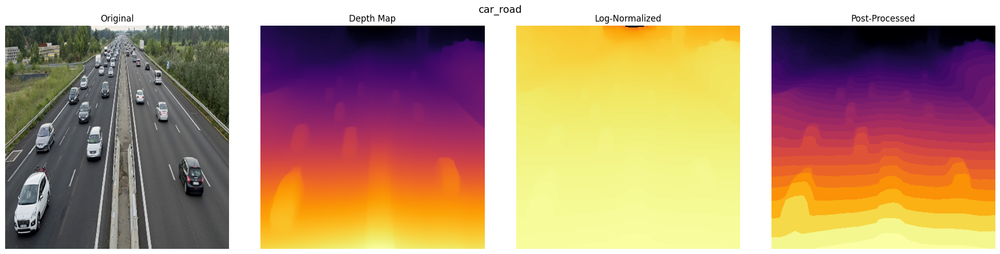

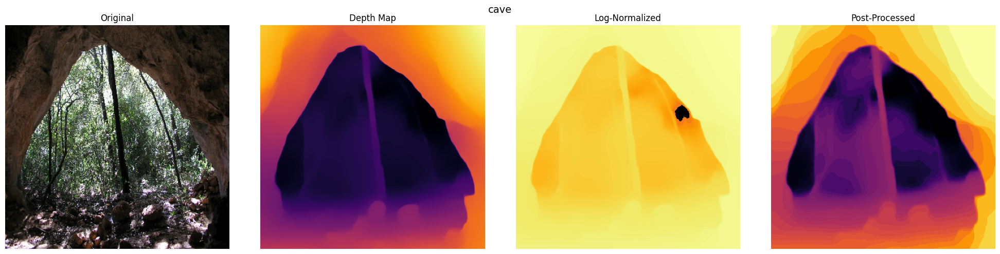

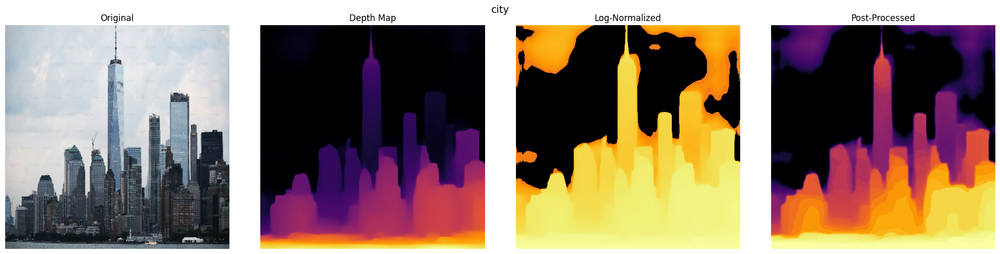

Processing Images:  31%|███▏      | 16/51 [01:03<02:24,  4.13s/it]

city_street: Inference time 2.95 sec


Processing Images:  33%|███▎      | 17/51 [01:06<02:07,  3.76s/it]

crowd: Inference time 2.87 sec


Processing Images:  33%|███▎      | 17/51 [01:09<02:07,  3.76s/it]

crowd2: Inference time 2.92 sec


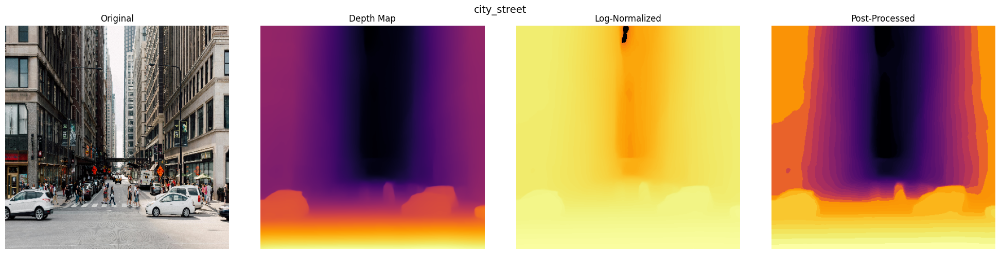

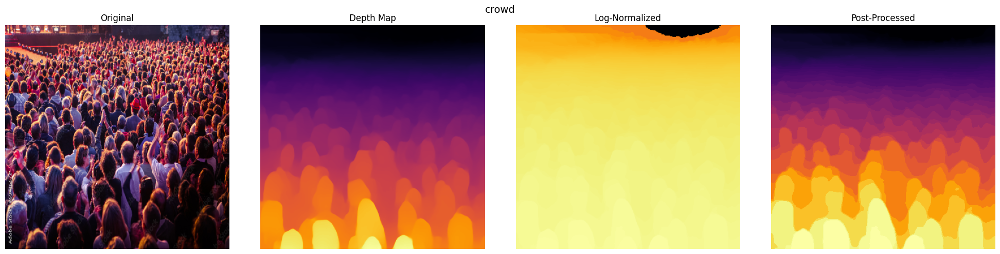

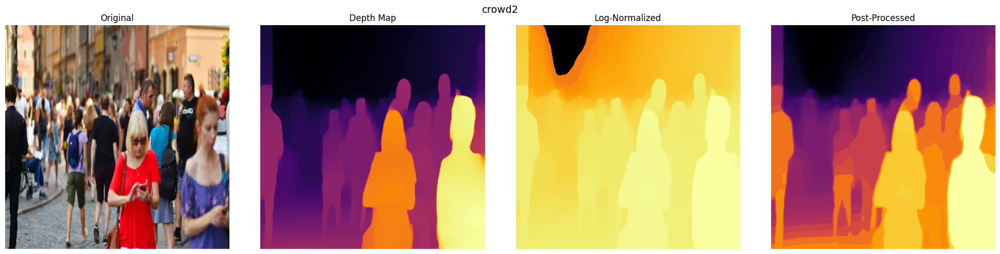

Processing Images:  37%|███▋      | 19/51 [01:15<02:08,  4.01s/it]

cycling: Inference time 3.14 sec


Processing Images:  39%|███▉      | 20/51 [01:18<01:53,  3.68s/it]

dark_alleyway: Inference time 2.89 sec


Processing Images:  39%|███▉      | 20/51 [01:21<01:53,  3.68s/it]

desert: Inference time 2.85 sec


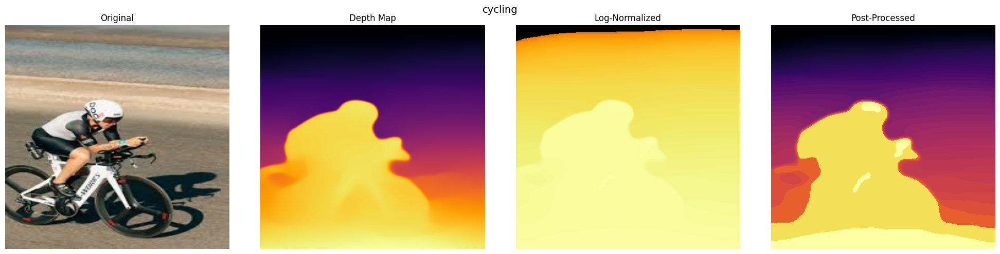

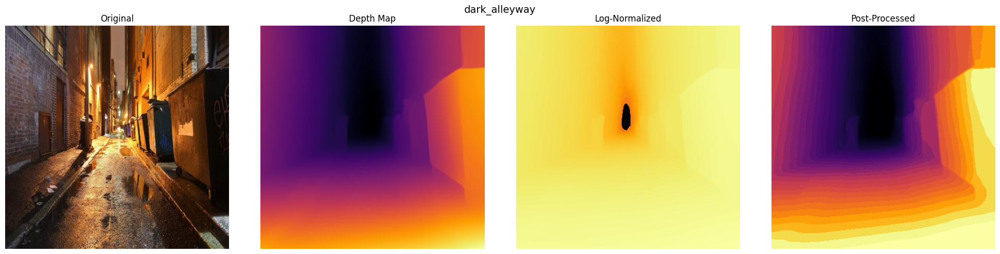

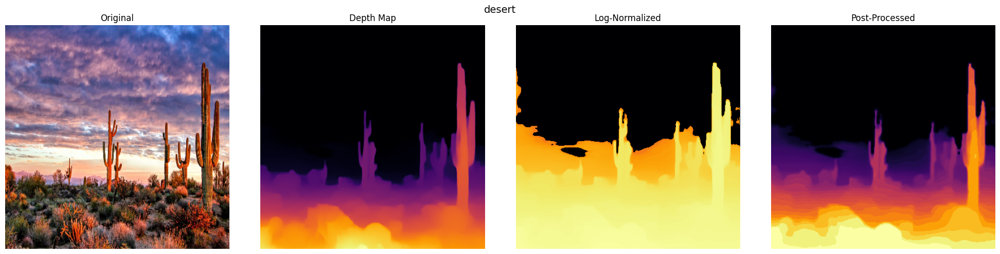

Processing Images:  43%|████▎     | 22/51 [01:26<01:50,  3.80s/it]

desert2: Inference time 2.91 sec


Processing Images:  45%|████▌     | 23/51 [01:29<01:40,  3.58s/it]

dog: Inference time 3.05 sec


Processing Images:  45%|████▌     | 23/51 [01:32<01:40,  3.58s/it]

football: Inference time 3.10 sec


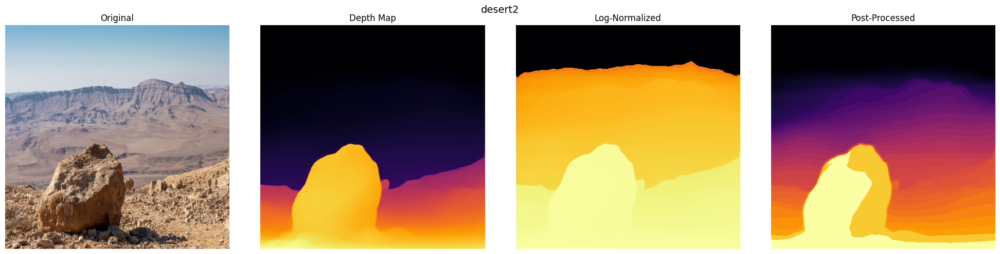

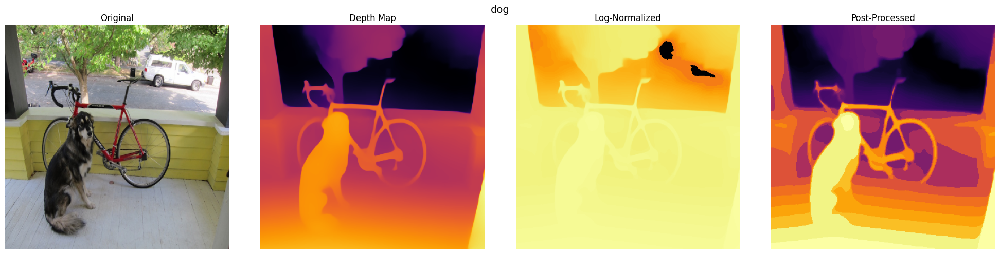

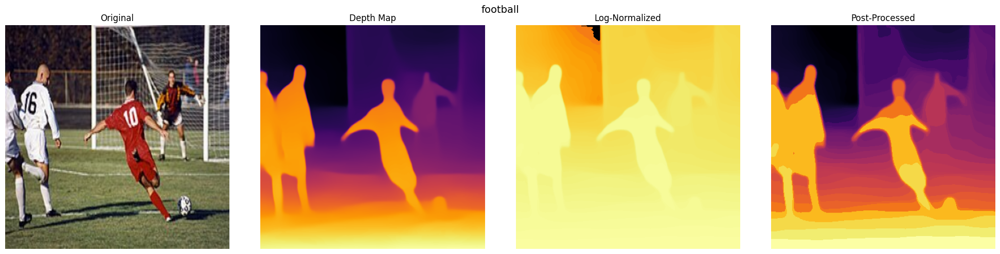

Processing Images:  49%|████▉     | 25/51 [01:38<01:40,  3.86s/it]

forest_trail: Inference time 2.92 sec


Processing Images:  51%|█████     | 26/51 [01:41<01:29,  3.57s/it]

harbor: Inference time 2.87 sec


Processing Images:  51%|█████     | 26/51 [01:44<01:29,  3.57s/it]

jo_2024: Inference time 3.11 sec


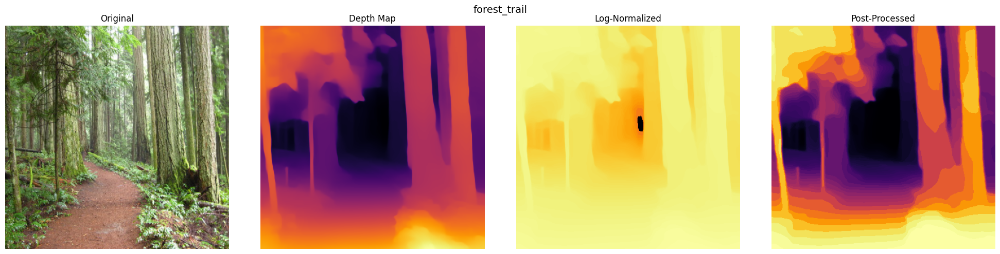

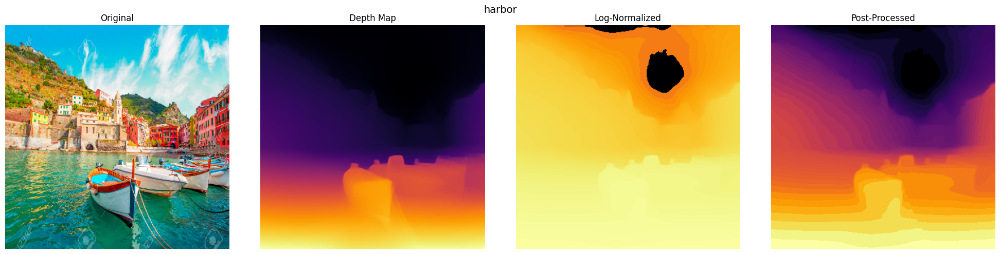

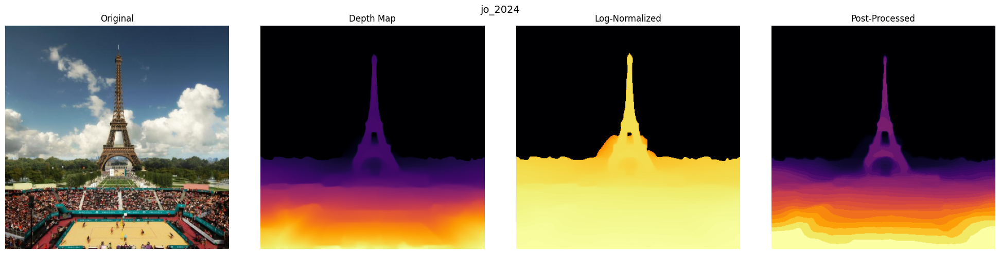

Processing Images:  55%|█████▍    | 28/51 [01:50<01:29,  3.89s/it]

kitchen: Inference time 2.98 sec


Processing Images:  57%|█████▋    | 29/51 [01:53<01:19,  3.59s/it]

lake: Inference time 2.87 sec


Processing Images:  57%|█████▋    | 29/51 [01:56<01:19,  3.59s/it]

library: Inference time 2.85 sec


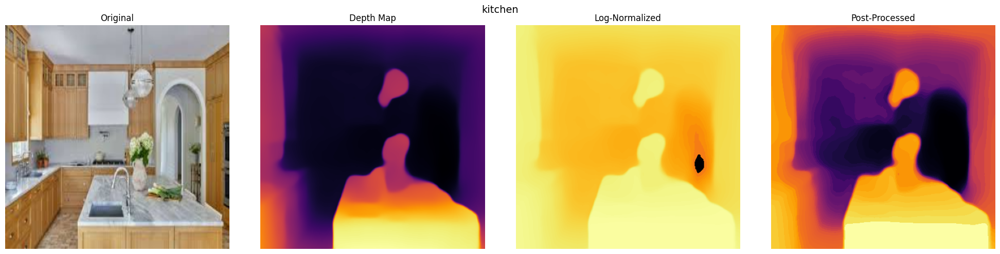

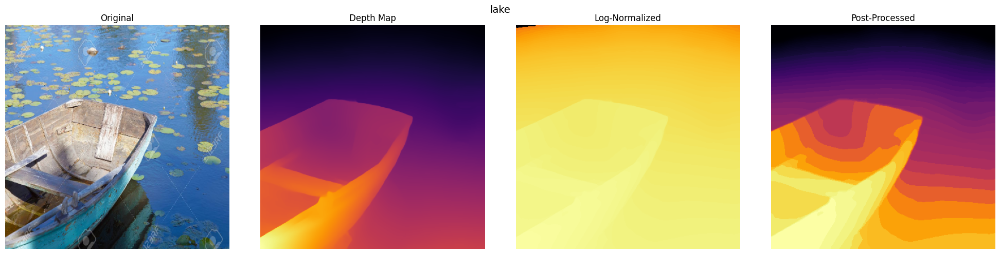

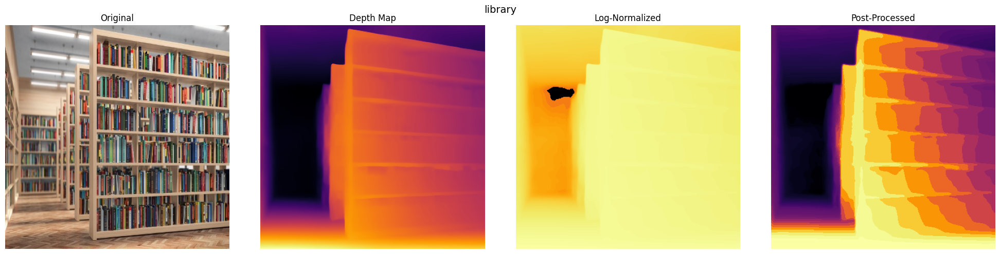

Processing Images:  61%|██████    | 31/51 [02:03<01:21,  4.08s/it]

living_room: Inference time 3.09 sec


Processing Images:  63%|██████▎   | 32/51 [02:05<01:10,  3.74s/it]

louvre_paris: Inference time 2.92 sec


Processing Images:  63%|██████▎   | 32/51 [02:08<01:10,  3.74s/it]

mont_saint_michel: Inference time 2.82 sec


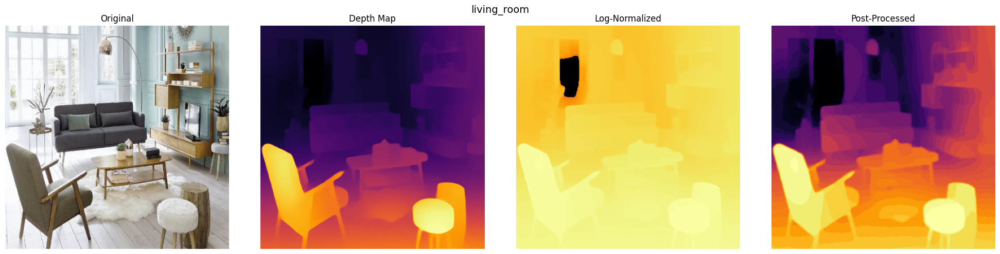

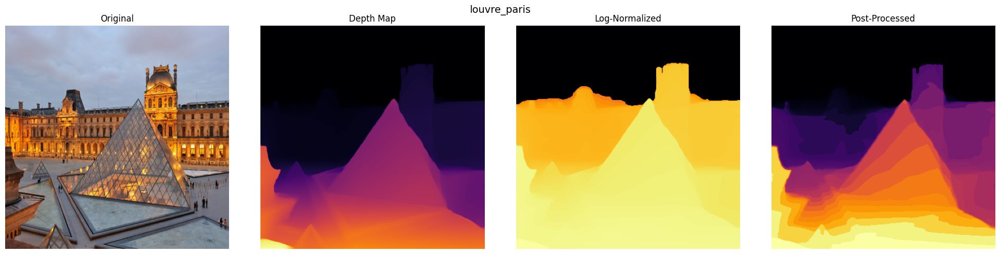

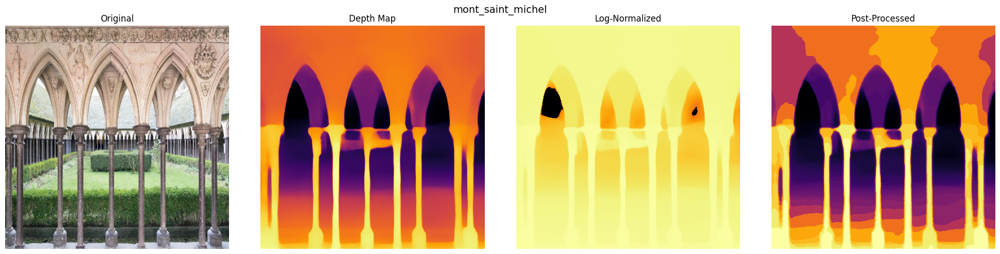

Processing Images:  67%|██████▋   | 34/51 [02:14<01:05,  3.86s/it]

mountain: Inference time 2.99 sec


Processing Images:  69%|██████▊   | 35/51 [02:17<00:57,  3.62s/it]

mountain_house: Inference time 3.03 sec


Processing Images:  69%|██████▊   | 35/51 [02:20<00:57,  3.62s/it]

mountain_lake: Inference time 3.00 sec


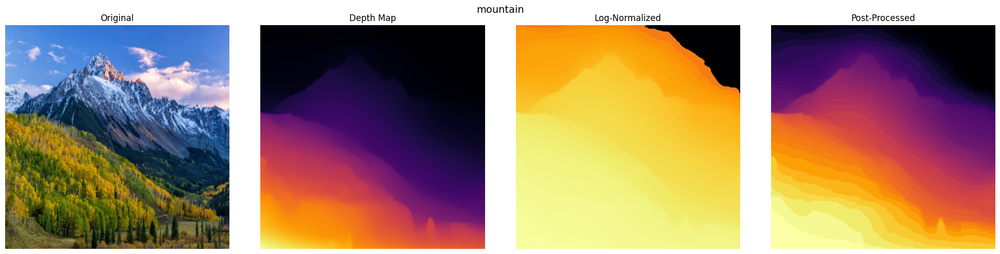

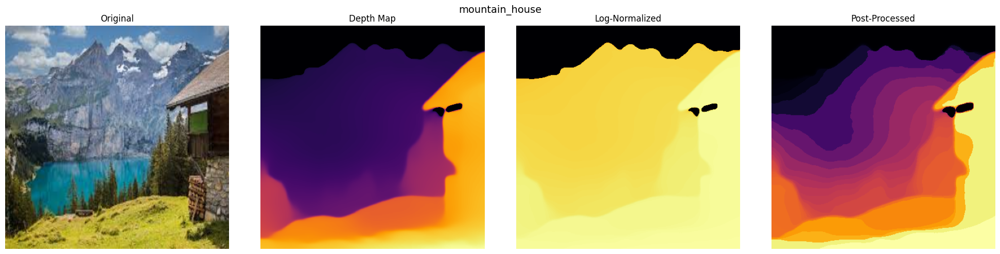

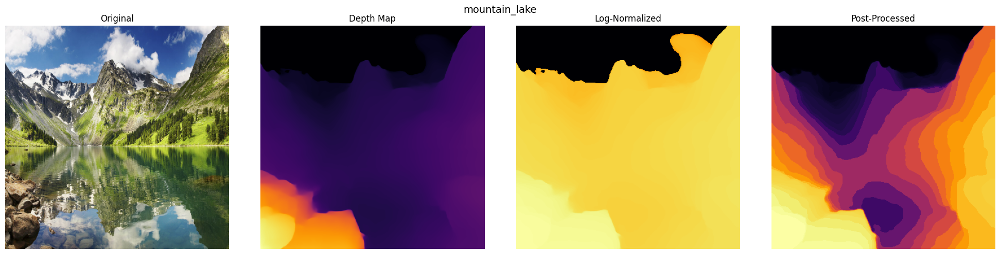

Processing Images:  73%|███████▎  | 37/51 [02:26<00:55,  3.97s/it]

mountain_river: Inference time 2.92 sec


Processing Images:  75%|███████▍  | 38/51 [02:29<00:47,  3.67s/it]

nature: Inference time 2.90 sec


Processing Images:  75%|███████▍  | 38/51 [02:32<00:47,  3.67s/it]

ocean_cliff: Inference time 2.90 sec


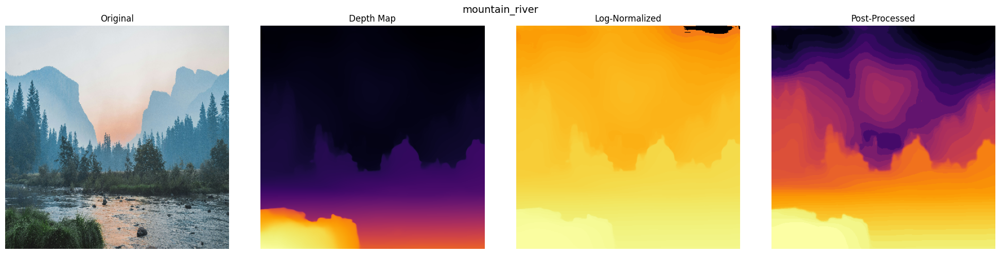

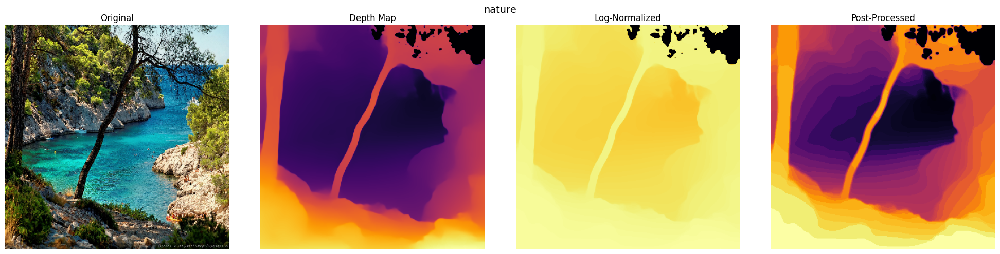

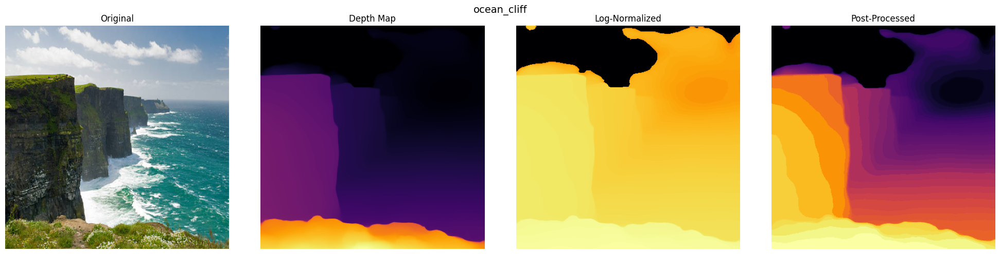

Processing Images:  78%|███████▊  | 40/51 [02:37<00:42,  3.86s/it]

paris: Inference time 2.91 sec


Processing Images:  80%|████████  | 41/51 [02:40<00:35,  3.57s/it]

parking: Inference time 2.88 sec


Processing Images:  80%|████████  | 41/51 [02:43<00:35,  3.57s/it]

parking2: Inference time 2.89 sec


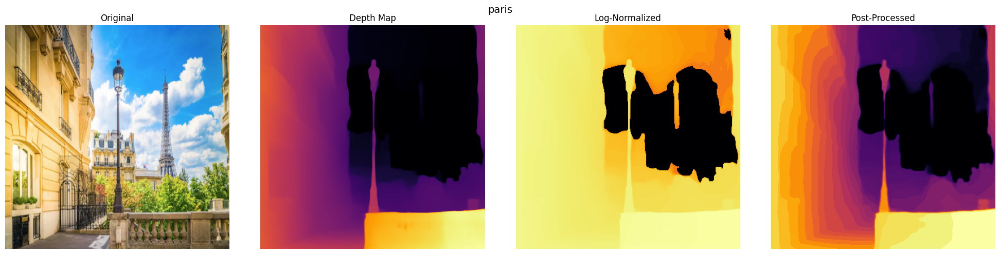

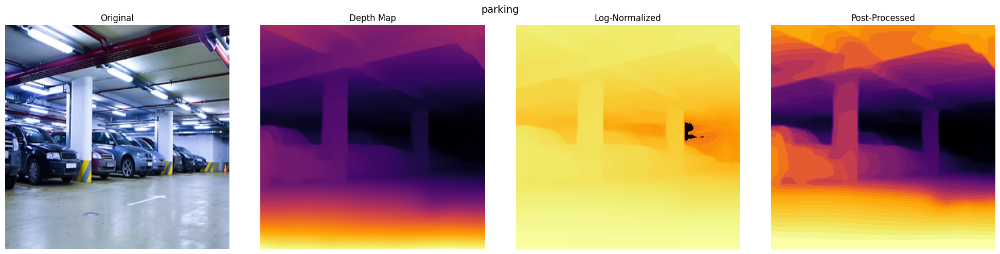

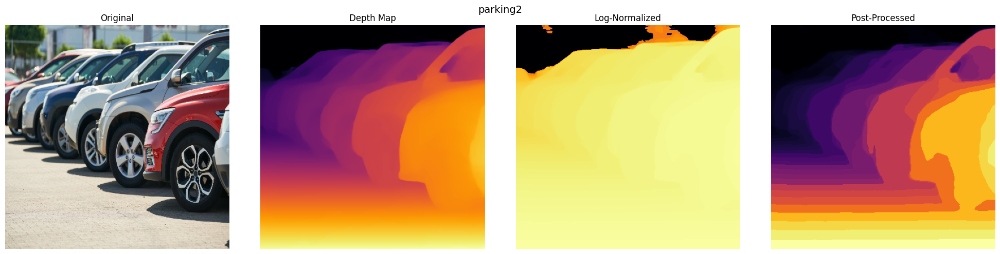

Processing Images:  84%|████████▍ | 43/51 [02:49<00:30,  3.83s/it]

plane_airport: Inference time 3.02 sec


Processing Images:  86%|████████▋ | 44/51 [02:52<00:25,  3.60s/it]

river: Inference time 3.05 sec


Processing Images:  86%|████████▋ | 44/51 [02:55<00:25,  3.60s/it]

road: Inference time 2.83 sec


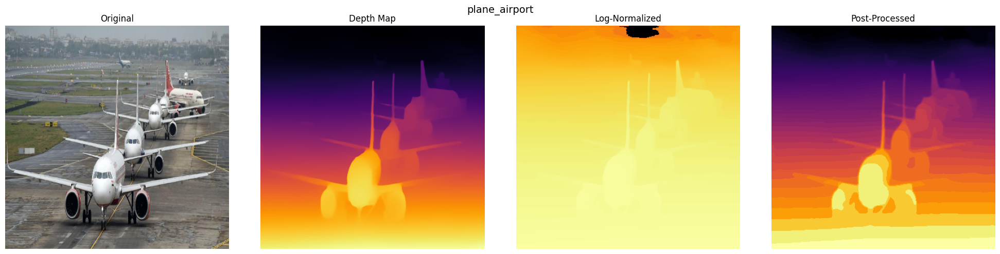

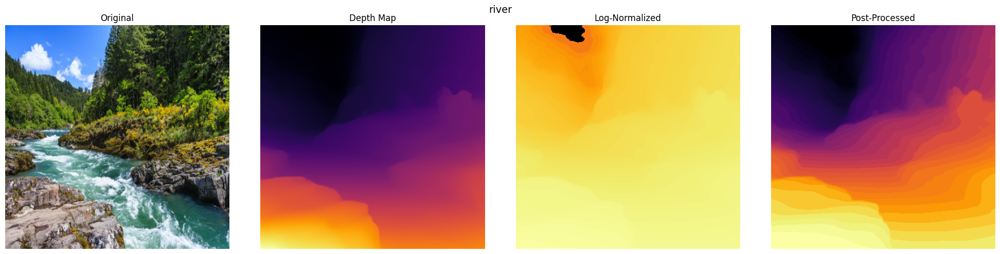

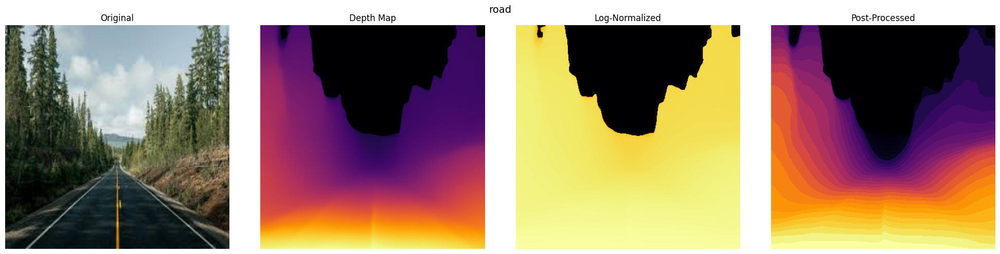

Processing Images:  90%|█████████ | 46/51 [03:01<00:19,  3.94s/it]

road2: Inference time 3.46 sec


Processing Images:  92%|█████████▏| 47/51 [03:04<00:14,  3.64s/it]

road_through_trees: Inference time 2.92 sec


Processing Images:  92%|█████████▏| 47/51 [03:07<00:14,  3.64s/it]

stadium: Inference time 3.05 sec


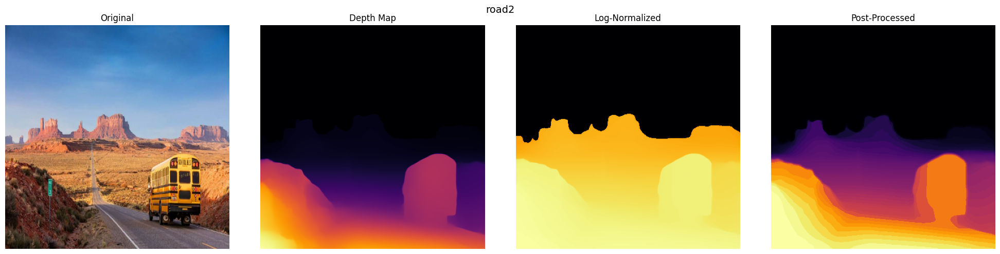

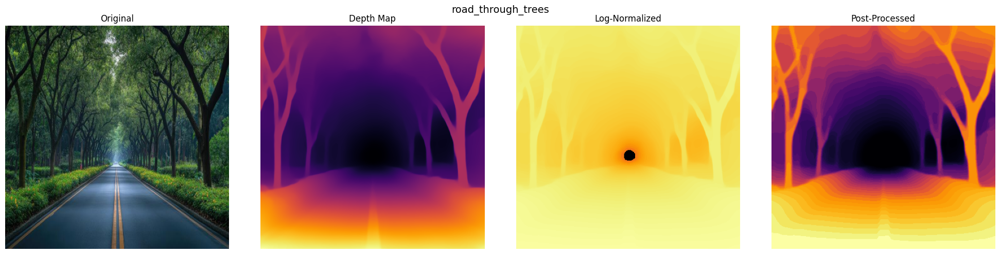

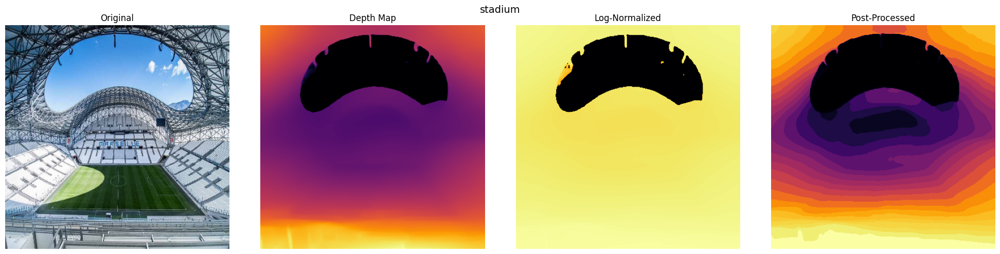

Processing Images:  96%|█████████▌| 49/51 [03:13<00:07,  3.89s/it]

street: Inference time 2.94 sec


Processing Images:  98%|█████████▊| 50/51 [03:16<00:03,  3.65s/it]

train: Inference time 2.95 sec


Processing Images:  98%|█████████▊| 50/51 [03:19<00:03,  3.65s/it]

village: Inference time 2.87 sec


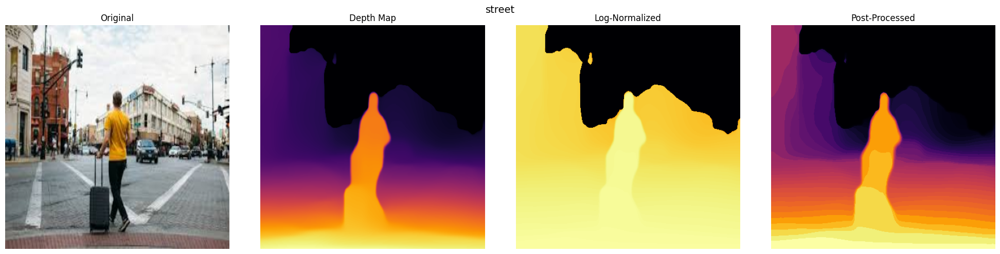

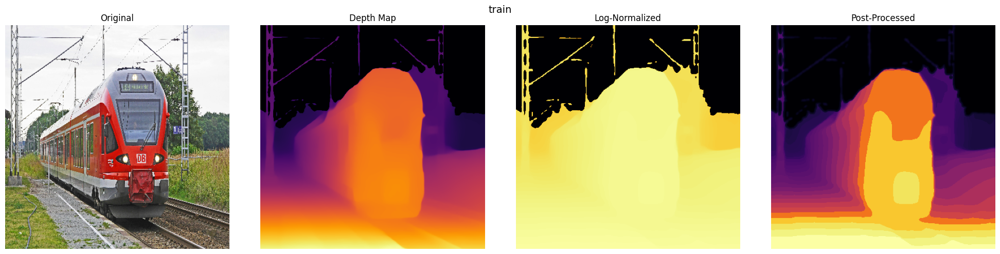

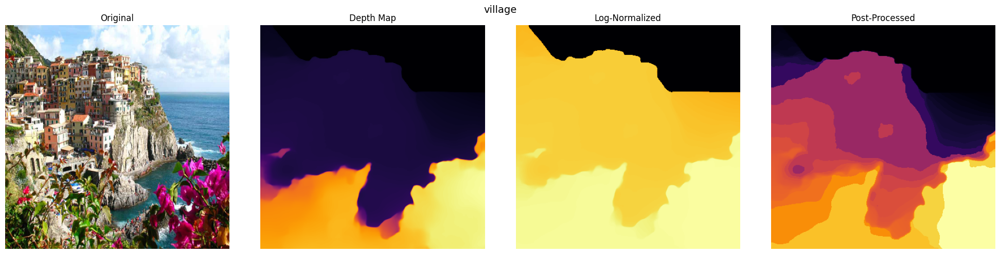

Processing Images: 100%|██████████| 51/51 [03:21<00:00,  3.96s/it]


Saving final NPZ archive...
Saved NPZ file to ./outputs\depth_estimation_results_postprocessed.npz

Finished. Total time: 0:03:35


In [16]:
# Run the pipeline
if __name__ == "__main__":
    run_depth_estimation(CONFIG)

# 